# Text Mining for Hypothesis Generation - Improvements and Validation
Group Members: Raya Kavosh, Ian Carrasco, Braden Riggs, Ron Hasson, Cameron Goharbin, Justin Yang, Maxwell Chen, Mor Greenbaum

- Maxwell Chen ([GitHub](https://github.com/Xawwell), [LinkedIn](https://www.linkedin.com/in/maxchen1389/), [Twitter](https://twitter.com/CMaxwellsPFC))

- Cameron Goharbin ([Github](https://github.com/cameron-g), [LinkedIn](https://www.linkedin.com/in/cameron-goharbin/))

- Ron Hasson ([Github](https://github.com/Rohass20), [LinkedIn](https://www.linkedin.com/in/ronhasson/))

- Raya Kavosh ([Github](https://github.com/raya-kavosh))

- Braden Riggs ([GitHub](https://github.com/Briggs599), [LinkedIn](https://www.linkedin.com/in/briggs599/), [Twitter](https://twitter.com/BradenRiggs1))

- Justin Yang ([GitHub](https://github.com/justintheyang), [LinkedIn](https://www.linkedin.com/in/justintheyang/))

- Ian Carrasco ([Github](https://github.com/IanCarrasco), [LinkedIn](https://www.linkedin.com/in/ian-carrasco/))

(FOR PUBLIC RELEASE)

## Overview 
>In this work, we aim to develop new approaches to automated hypothesis generation by utilizing the vast neuroscience literature. Building on prior work in semi-automated hypothesis generation, we present a hypothesis-first algorithm for computing a hypothesis "attractiveness" metric which is more robust to spurious correlations (Voytek & Voytek, 2012). Using our proposed algorithm to generate hypotheses using PubMed data collected from the years 1700 to 2000, we then validate said hypotheses on data from 2000 to the present based on increased word mentions. This validation is used as a benchmark to quantify the strength of our proposed algorithm and demonstrate the potential to generate future hypotheses to be pursued.

## Research Question
>##### Can we generate valid hypotheses and assess their prevalence across time by utilizing a percent change measure gathered from large-scale, time-based analysis of neuroscience literature?

## Background & Prior Work
>With neuroscientific research being published at an increasingly high rate, it is becoming increasingly difficult for individual researchers to keep up with the field, potentially missing novel interactions between topics that can advance current research. Thus, there is a growing need to create automated techniques capable of analyzing the vast literature and identifying possible gaps in our neuroscientific knowledge. 

>In recent years, approaches have been proposed to solve a problem known as *automated hypothesis generation*, which, at a high level, attempts to find said missing interactions by performing large-scale analysis across field-wide literature databases (i.e. PubMed). Voytek, et al.[1] proposed an algorithm based upon finding terms in the literature that show a large number of shared publications between two child terms and a parent term with a considerably less amount of publications between the two child terms. More recent work by Wilson et al. [2] and Sybrant et al. [3], utilized natural language processing (NLP) approaches to parse abstracts to find significant interactions between cancer genes and various biomedical research topics, respectively.
Additionally, other approaches have proposed deep-learning based solutions operating on graph representations of term interactions as seen in [4]. <br/>

>In our project our goals are two-fold. First, we aim to develop a new algorithm for identifying and ranking candidate hypotheses accurately. Second, we propose a framework and dataset that allows candidate hypotheses to be validated by their characteristics in future periods. Particularly, we use *term co-occurrence* aggregated from the years 1700-2000 to generate hypotheses which we then validate using co-occurrence data from 2000-present, by computing percent increase in citations between the two periods.

### Data Collection 
>We based our data collection on the same 591 neuroscience terms that were analyzed in Voytek[1], to provide a reasonable benchmark to compare our models against. Using these terms, we utilized the NCBI E-Utils API to fetch intersection and union counts for the ~174k hypotheses (term-pairs) for the years 1700-2000 and 2000-2021 that were based on a term's presence in either the title and/or abstract of a given paper. For example, given a term pair (t1, t2), we would query all papers in a given time period whose titles and/or abstracts contain both t1 AND t2, and compute the sum of t1 NOT t2 and t2 NOT t1. From here, we constructed three matrices where the entries in each represented the intersection, union, and intersection over union (connectivity).

> To make the fetching of multiple time periods reasonable we designed a scraper, called MicroLisc (*full source: ./data_collection/microlisc.py*), that utilizes multi-threading to make requests with a throughput of ~200 requests/sec. Additionally, we were able to vastly reduce the number of requests via caching since |X NOT Y| + |Y NOT X| = |X| + |Y|, when there are no intersections between X AND Y. Hence, by checking for intersection first, we could then retrieve the cardinalities of X and Y from a cache, leaving most hypotheses only requiring only 1 HTTP request (not intersecting), and at max 3 HTTP requests (if intersecting). The combination of these two optimizations allowed us to collect the complete set of hypothesis data for an entire time period in under 1.5 hours. We believe this decrease in data collection time will facilitate further analysis of multiple time periods.

### Hypothesis
Our algorithm's method of computing the "attractiveness" metric allows for the hypotheses to be compared on an ordinal scale. In doing so, our hypotheses will be more robust to spurious correlations and have greater specificity. We conjecture that these features of the resulting hypotheses make them more meaningful in terms of their utility in predicting future trends in neuroscience.

## Data Analysis

In [1]:
# import general utilities
import os # Filesystem Interaction
import pandas as pd # Dataframe Processing
import numpy as np # Numerical Computation
import time # Benchmarking
from itertools import chain, cycle, compress
from scipy.stats import spearmanr

# import tools used in this project
from hfalgo import HypothesisFirst
from neighbors import NeighborAnalysis
from Voytek_Algorithm import Voytek_alg
from data_collection.microlisc import MicroLisc 
from data_collection.utils import check_symmetric, percentage_change

# set up plotting environment
import seaborn as sns
import plotly.express as px
import ipywidgets as widgets
import matplotlib.pyplot as plt
from IPython.display import display, HTML, clear_output, Image, display_html
display(HTML("<style>.container { width:75% !important; }</style>"))


### Data Wrangling
We configure our data directories and nest terms with their synonyms, producing a list of 591 terms (including synonyms). We then initialize our scraper(data_collection/microlisc.py) with this specific term set and run a job with a specified configuration, outlining the two time periods where we gather the conjunction, intersection, and connectivity counts.

#### Configuration and Brain Term Initialization

In [2]:
# set up directory & file hierarchy
proj_dir = os.getcwd()
data_dir = os.path.join(proj_dir,'data')
old_data_dir = os.path.join(proj_dir,'old_data')
new_data_dir = os.path.join(proj_dir,'new_data')
neighbor_data_dir = os.path.join(new_data_dir,'neighbors_of_neighbors')
hypothesis_data_dir = os.path.join(new_data_dir,'hypothesis_first')

# load in the 591 terms from the original analysis
df = pd.read_csv(os.path.join(data_dir, 'brain_terms_new.csv'), names= None)

# extract useful information from the dataframe
term_types = df.domain.unique()
mapping = dict(df[['term','domain']].values)
mapping_lower = {k.lower(): v for k, v in mapping.items()}

# Nest all unique terms from the terms dataframe
lis = [[f'"{j}"' for j in list(set(list(df[df.term == i]['synonyms']) \
                                 + list(df[df.term == i]['term'])))] for i in df.term.unique()]

assert len(lis) == 588

In [3]:
def fetch_data(**kwargs):
    '''
    Takes a configuration object (below) and fetches the relevant data
    
    '''
    # Instantiate MicroLisc
    ml = MicroLisc(terms=kwargs['terms'])

    # Run The Scraping Job
    print(f'Fetching from {kwargs["start"]} to {kwargs["end"]}')
    t_start = time.time()
    conj, disj = ml.run_collection(num_of_pairs=-1, date_range=(kwargs['start'], kwargs['end']))
    t_end = (time.time() - t_start)

    # Clean and Process the Conjunction and Disjunction Matrices
    d_idxs = np.diag_indices(conj.shape[0])
    conj[d_idxs] = 0
    disj[d_idxs] = 0

    # Turn left triangular matrix into symmetrical matrix since (t1, t2) <-> (t2, t1)
    conj += conj.T
    disj += disj.T
    
    # Build Connectivity (IoU) Matrix
    np.seterr(divide='ignore', invalid='ignore')
    conn = conj_pre/disj_pre
    conn[d_idxs] = 1
    conn = np.nan_to_num(conn)

    # Make Sure Matrices Are Symmetrical
    assert check_symmetric(conn) == True
    assert check_symmetric(conj) == True
    assert check_symmetric(disj) == True
    
    
    print(f'Total Time: {end:0.3f}s')
    print('Saving Matrices...')
    
    # Write matrices to files
    np.savetxt(f'./conj_{out_prefix}.csv', conj, delimiter=',')
    np.savetxt(f'./disj_{out_prefix}.csv', disj, delimiter=',')
    np.savetxt(f'./conn_{out_prefix}.csv', conn, delimiter=',')

#### Skip These Cells to Use Already Downloaded Data

In [4]:
# '''
# Configuration Fields:
#     start: The start date in YYYY/MM/DD format
#     end: The end date in YYYY/MM/DD format
#     out_prefix: Prefix for output files
# '''

# # Initialize Configuration for Scraping
# CONFIG_PRE = {'start':'1700/01/01', 
#               'end':'1999/12/31', 
#               'out_prefix':'pre_2000',
#               'terms': lis}

# CONFIG_POST = {'start':'2000/01/01', 
#                'end':'2021/03/08', 
#                'out_prefix':'post_2000',
#                'terms': lis}

In [5]:
# fetch_data(**CONFIG_PRE)

In [6]:
# fetch_data(**CONFIG_POST)

### Data Visualization

In [7]:
# Load pre- and post- 2000 dataframes
d_pre = np.genfromtxt(os.path.join(new_data_dir, 'disj_pre.csv'), delimiter=',')
d_post = np.genfromtxt(os.path.join(new_data_dir, 'disj_post.csv'), delimiter=',')
c_pre = np.genfromtxt(os.path.join(new_data_dir, 'conj_pre.csv'), delimiter=',')
c_post = np.genfromtxt(os.path.join(new_data_dir, 'conj_post.csv'), delimiter=',')
cn_pre = np.genfromtxt(os.path.join(new_data_dir, 'conn_pre.csv'), delimiter=',')
cn_post = np.genfromtxt(os.path.join(new_data_dir, 'conn_post.csv'), delimiter=',')

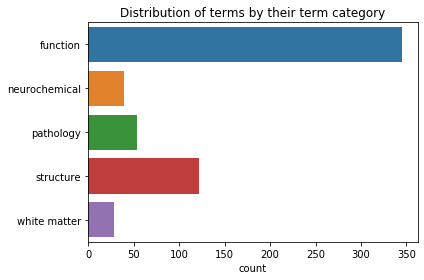

In [8]:
sns.countplot(y=df.drop_duplicates('term').domain)
plt.title('Distribution of terms by their term category')
plt.ylabel('')
plt.tight_layout()
plt.savefig('visuals/terms_dist.png')

Amongst, the terms we based our generation upon a majority of them belonged to the functional category.

In [9]:
np.fill_diagonal(cn_pre,0)
np.fill_diagonal(cn_post,0)


outlier_removed_pre = cn_pre[(cn_pre >= 0) & (cn_pre < 1)]
outlier_removed_post = cn_post[(cn_post >= 0) & (cn_post < 1)]

In [10]:
cn_df =pd.DataFrame(dict(
    series=np.concatenate(([f"pre-2000 mean: {outlier_removed_pre.mean():0.3f}"]*len(outlier_removed_pre), \
                           [f"post-2000 mean:{outlier_removed_post.mean():0.3f}"]*len(outlier_removed_post))), 
    data=np.concatenate((outlier_removed_pre,outlier_removed_post))
))

cn_df.replace(0,10e-8,inplace = True)
cn_df['data'] = np.log10(cn_df['data'])

fig = px.histogram(cn_df,x="data", color="series", 
                   nbins=100, log_y=True,
                   labels=dict(x="Connectivity"),
                   barmode="overlay", title='Connectivity Pre-2000 vs. Post-2000')
fig.update_xaxes(nticks=20, range=[-7.5,.5], title_text="Connectivity")
fig.update_yaxes(title_text="Count")


<img src="https://drive.google.com/uc?id=1rDTnMCIl7QUVoZZHAAhYQ1ZcKJnsJinZ">

The distribution of Jaccard indices in both the pre- and post- 2000 data have a similar fall off as the the index increases. We then see a bin centered at 1 which is of size 591 that is representative of the jaccard index of a term and itself.

#### Connectivity Explorer
Interactive widget to look at the percentage change in connectivity across pre-2000 and post-2000 data

In [11]:
# Instantiate a new MicroLisc object for indexing helpers
ml = MicroLisc(terms=lis)

# Sort terms alphabetically
sorted_terms = sorted(lis, key=lambda x: x[0].lower())

# Event Handler for Button Click
def on_button_clicked(b):
    with output:
        output.clear_output()
        # Fetch Relevant Entry in Connectivity Matrix
        r = ml.term_to_idx[tuple(term1.value)]
        c = ml.term_to_idx[tuple(term2.value)]
        
        # Calculate percent growth across pre- and post-
        change = percentage_change(pre=cn_pre[r][c], post=cn_post[r][c])
        
        # Display.
        output.append_display_data(HTML(f'<h4>Connectivity: {cn_pre[r][c]:0.3e} (Pre) | {cn_post[r][c]:0.3e} (Post) | {change:0.3f}% (Percent Change) </h4>'))


# Generate GUI 
term1 = widgets.Dropdown(
    options=sorted_terms,
    value=sorted_terms[0],
    description='Term 1:',
    disabled=False,
)
term2 = widgets.Dropdown(
    options=sorted_terms,
    value=sorted_terms[1],
    description='Term 2:',
    disabled=False,
)

button = widgets.Button(
    description='Get Connectivity',
    disabled=False,
    button_style='info', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Get Data',
    icon='arrow-right' # (FontAwesome names without the `fa-` prefix)
)

output = widgets.Output()

button.on_click(on_button_clicked)
hb = widgets.HBox([term1, term2, button])
widgets.VBox([hb, output])

## Approaches and Methods

### Neighbors of Neighbors connectivity transformation

Our hypothesis generation algorithms rely on jaccard index connectivity, however this only reflects the popularity of terms in the scientific literature. <i>Not</i> the actual relatedness of two terms. And so there is an implicit assumption stating that two terms are related when the scientific literature references them together often. <br>

The <b>neighbors of neighbors tranformation</b> tries to fix this, while still relying on the scientific literature. In essence, it reflects the held belief in distributional semantics that <i>"you shall know a word by the company it keeps."</i><br>

Conceretely, the relatedness of two terms $a$ and $b$ is the jaccard index of the $n$ neighbors most similar to term $a$ and the $n$ neighbors most similar to term $b$. 


Here are the terms most related to memory. Just on inspection, it seems to be recommending better terms than the original connectivity matrix it was based off of.

Words with highest connectivity to memory from the pre-2000 connecvity matrix

In [12]:
conj_df = pd.read_csv(os.path.join(new_data_dir, 'conn_pre.csv'), header=None)
conj_df.columns, conj_df.index = df.term.unique(), df.term.unique()
conj_df['memory'].nlargest(10)

memory                 1.000000
learning               0.098232
short term memory      0.056706
working memory         0.049321
amnesia                0.047396
hippocampus            0.046770
dementia               0.035915
long term memory       0.033667
Alzheimer's disease    0.031437
recognition memory     0.030314
Name: memory, dtype: float64

In [13]:
na = NeighborAnalysis()
na.get_related_terms(query='memory')

Most related to memory by category 'function': 
 Index(['Alzheimer's disease', 'amnesia', 'long term memory', 'entorhinal area',
       'short term memory', 'basal forebrain nucleus', 'cognition', 'dementia',
       'dentate gyrus', 'forgetting'],
      dtype='object') 

Most related to memory by category 'neurochemical': 
 Index(['histamine', 'facial nucleus', 'hippocampus', 'learning',
       'somatosensation', 'Alzheimer's disease', 'acetylcholine', 'amnesia',
       'caudate nucleus', 'claustrum'],
      dtype='object') 

Most related to memory by category 'pathology': 
 Index(['declarative memory', 'learning', 'acetylcholine',
       'delayed recognition', 'fastigial nucleus', 'fornix',
       'stria terminalis', 'uncertainty', 'Alzheimer's disease', 'GABA'],
      dtype='object') 

Most related to memory by category 'structure': 
 Index(['learning', 'Alzheimer's disease', 'corpus callosum', 'seizure',
       'Huntington's disease', 'alcoholism', 'attention', 'cognition',
       '

The results above, indicate the related terms to a source term, in this case memory, that share a parent from a specific term category.

/home/AD/juy003/Projects-W21-text-mining/neighbors.py:63: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



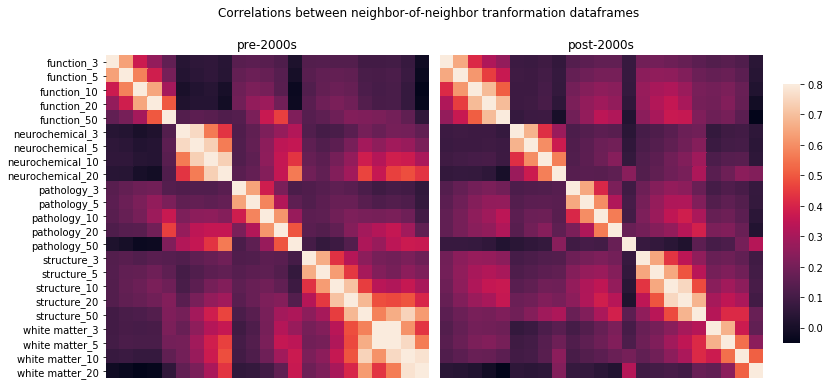

In [14]:
na.generate_heat_maps()

##### Correlation of neighbors-of-neighbors dataframes (hyperparameter search). <br>
We see that datasets within the same term category are most closely correlated with one another, where (within-term category) the correlations highest for the closest number of neighbors analyzed. <br> Suprisingly, the correlations between dataframes are relatively low.

In [15]:
# get all neighbors-of-neighbors dataframes into list
term_nvals_before, term_nvals_after = [], []
names_before, names_after = [], []

for term in term_types:
    for n in [3, 5, 10, 20, 50]:
        try:
            assc_before = pd.read_csv(os.path.join(neighbor_data_dir, \
                          f'pairwise_logtransform_{n}nn_{term}_pre.csv'), index_col = 0).values.flatten()
            term_nvals_before.append(assc_before)
            names_before.append(f'{term}_{n}')            
            assc_after = pd.read_csv(os.path.join(neighbor_data_dir, \
                          f'pairwise_logtransform_{n}nn_{term}_post.csv'), index_col = 0).values.flatten()
            term_nvals_after.append(assc_after)
            names_after.append(f'{term}_{n}')
        except: 
            pass

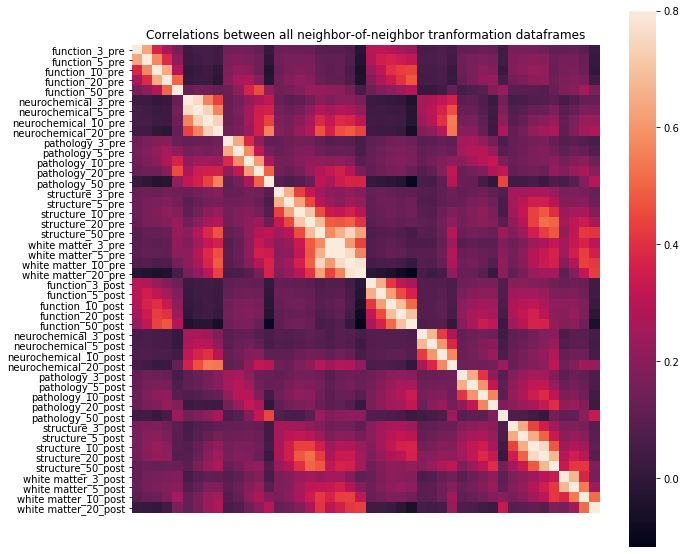

In [16]:
names_full = [*[names + '_pre' for names in names_before], *[names + '_post' for names in names_after]]
terms_full = [*term_nvals_before, *term_nvals_after]

plt.figure(figsize = (10,8))
sns.heatmap(spearmanr(terms_full, axis=1)[0], square = True, \
            yticklabels=names_full, xticklabels=False, vmax=0.8)
plt.title('Correlations between all neighbor-of-neighbor tranformation dataframes')
plt.tight_layout()
plt.show()

How are the transformed jaccard indices distributed across all transformations?

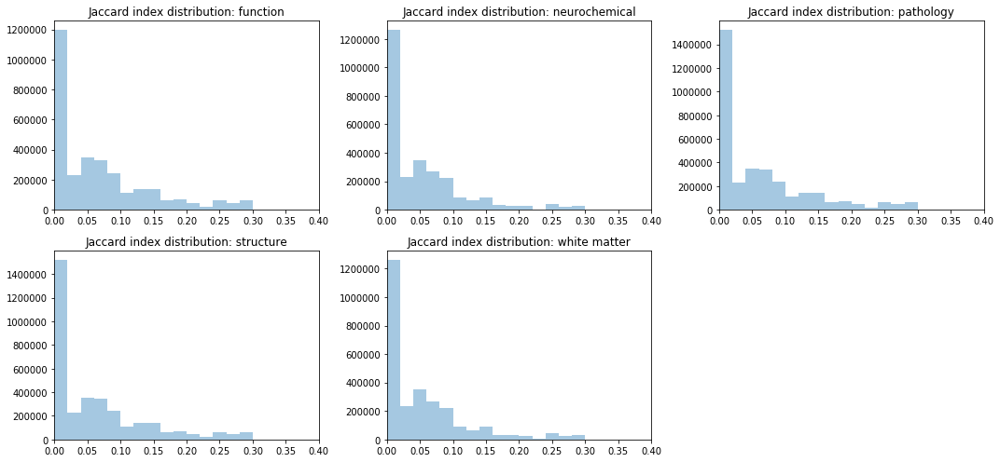

In [17]:
fig=plt.figure(figsize=(15,7), constrained_layout=False)
col, row = 3,2
type_index = [list(filter(lambda i: term in names_full[i], range(len(names_full)))) for term in term_types]
for i, term in enumerate(term_types):
    ind = list(filter(lambda j: term in names_full[j], range(len(names_full))))
    corrs = np.asarray(list(compress(terms_full, ind))).flatten()
    fig.add_subplot(row, col, i+1)
    plt.ticklabel_format(axis="y", style="sci")
    plt.title(f'Jaccard index distribution: {term}')
    sns.distplot(corrs, kde=False)
    plt.xlim(0, 0.4)
plt.tight_layout()


Unfortunately, we did not use the 'neighbor or neighbors' transformation on our hypothesis generation, however we predict that it might lead to more valid hypotheses that does not necessarily depend so heavily on the current scientific literature.

### 'Hypothesis-First' Attractiveness Algorithm

At its core, the hypothesis-first attractiveness algorithm relies on the same principle as Voytek's algorithm: "a friend-of-a-friend should be a friend". <br>

The hypothesis-first algorithm improves on this idea by evaluating "friend of a friend" criterion over all parent terms:

<img src="https://drive.google.com/uc?id=1orAvoXuUt-u-laSwMacmIu9lIdevPd_a" alt="description of algorithm" width = '800'>

The total number of parent terms that strongly relate two terms is the score of "attractiveness" between two terms. If two terms are strongly related to one another, they should share this link for <i>many</i> parent terms. By using this method, we are able to store <i>which</i> parent terms relate the two terms. Moreover, since our terms can be partitioned into 5 term categories (e.g., function), we are also able to analyze <i>in which categories</i> are the terms related. This gives us several advantages: 
- robustness to spurious correlations (popular topics dominating generated hypotheses)
- ordinal - not binary - measurement scale allows us to rank and compare how good the hypotheses are
- comparability across time scales (did the attractiveness go up or down?)
- greater specificity: now that we know this hypothesis is attractive, <i>where</i> should we start looking? We should look for similarities in their parents to find out.

Given three terms, P, H1, and H2, the algorithm employed in the Voytek & Voytek paper recommends terms H1 and H2 as a hypothesis if the following requirements are met:
- There exists a term P which has a conjunction with term H1 of over 1000 papers, and a conjunction with term H2 of over 1000 papers. 
- Terms H1 and H2 have a conjunction of less than 30 papers.



A potential area for improvement of this generation method is its lack of robustness in regards to it being skewed towards popular or commonly used terms in the literature. The hypothesis first model takes a different approach, in order to address this issue. In our model, the threshold that we use to determine a good hypothesis depends on the parent term. For candidate hypothesis terms $h_1$ and $h_2$ and parent term $p$, a triplet is defined as being a good hypothesis when:
- The jaccard index between $p$ and $h_1$ is in the top $n$ percentile of jaccard indices associated with parent $p$. 
- The jaccard index between $p$ and $h_2$ is in the top $n$ percentile of jaccard indices associated with parent $p$. 
- The jaccard index between $h_1$ and $h_2$ is in the bottom $l$ percentile of jaccard indices associated with parent $p$.

The bottom threshold needs to be adjusted to reflect the bottom $l$ percentile of jaccard indices associated with hypothesis $h_1$ or $h_2$, however the current parameters $l$ is tested on (0.4, 0.55) almost always necessitates $h_1$ and $h_2$ to have a jaccard index of 0. The upper threshold parameters are currently (0.95, 0.85), respectively. This gives us a <i>strict</i> and a <i>lax</i> attractiveness measure: 
- $l = 0.40$, $n = 0.95$
- $l = 0.55$, $n = 0.85$

In [ ]:
hf = HypothesisFirst(generate_hypothesis_matrices=True)
hf.plot_attractiveness_distribution()

Distribution of attractiveness scores of predicted hypotheses for each metric (relaxed and strict)

##### These are the top 10 most attractive hypotheses in the strict and lax algorithms, based on data pre-2000

In [ ]:
hf.generate_top_k_hypotheses(k=10, mode='relaxed')

In [ ]:
hf.generate_top_k_hypotheses(k=10, mode='strict')

Are these hypotheses valid? Looking at <i>only</i> the top hypothesis for the two metrics, it appears to be the case. <br>

The best hypothesis for the strict metric is a link between the <b>inferior parietal lobule</b> and <b>broca's area</b>. According the [first result on google](https://thebrain.mcgill.ca/flash/i/i_10/i_10_cr/i_10_cr_lan/i_10_cr_lan.html) when searching up these two terms, it appears to be the case:

> For many years, scientists’ understanding of how the brain processes language was rather simple: they believed that Wernicke’s area interpreted the words that we hear or read, then relayed this information via a dense bundle of fibres to Broca’s area, which generated any words that we spoke in response. But subsequent experiments with brain imaging have revealed the existence of a third region of the brain that is also indispensable for language. <br> <br>
> This region is the inferior parietal lobule, also known as “Geschwind’s territory”, in honour of the American neurologist Norman Geschwind, who foresaw its importance as early as the 1960s. Brain imaging studies have now shown that the inferior parietal lobule (angular gyrus and supramarginal gyrus) is connected by large bundles of nerve fibres to both Broca’s area and Wernicke’s area. Information might therefore travel between these last two areas either directly, via the arcuate fasciculus, or by a second, parallel route that passes through the inferior parietal lobule.

This is supported by Web of Science analytics, which shows that no articles were published (pre-2000, hence the chart starting at 2000) containing these two terms in their title: 

(publications per year)
<img src="https://drive.google.com/uc?id=1fiEENgpwikgLOYOUfqU4uv_7EkHoI5d7" alt="description of algorithm" width = '800'>The best hypothesis for the lax metric is a link between the <b>verbal memory</b> and <b>eye movement</b>. According a research article published in 2016 named "[Listen up, eye movements play a role in verbal memory retrieval](https://www.researchgate.net/publication/269820004_Listen_up_eye_movements_play_a_role_in_verbal_memory_retrieval)" when searching up these two terms, it appears to be the case. Here is the Web of Science publication-over-time chart: 

<img src="https://drive.google.com/uc?id=1GpOpn4-bk3e5TlxV86OdABXWXtC5xtEF" alt="description of algorithm" width = '800'>
The following graph demonstrates the ability of the hypothesis first model to find and recommend hypotheses for rarely studied terms. The inferior parietal lobule had only been studied in around 100 papers up to the year 2000. In the following years, the inferior parietal lobule was heavily explored, climbing up to numbers in the thousands of papers. The hypothesis first model  predicted a strong connection between broca’s area and the inferior parietal lobule, which ended up being studied in the post 2000 years.  The model utilized by Voytek and Voytek would have been unable to predict this hypothesis, simply due to the small amount of papers written about the inferior parietal lobule: 

<img src="https://drive.google.com/uc?id=1Zx-5ky402vhImHAhOJzIuKcfO6cvEhg-" width='800'>


Although a few papers were published pre-2000, the increase post-2000 is quite significant. There is good evidence that this algorithm is producing fruitful hypotheses.

##### These are the top 10 most attractive hypotheses for the future (post-2020) using the strict and lax algorithms, based on data from 2000-present

In [ ]:
lax_pre, lax_post, strict_pre, strict_post = hf.get_hypothesis_matrices()

In [ ]:
hf.generate_top_k_hypotheses(k=10, mode='relaxed', lm=lax_post)

In [ ]:
hf.generate_top_k_hypotheses(k=10, mode='strict', sm=strict_post)

#### Headline from July 2020 mentioning a link between projections from the thalamus (location of pulvinar) and the cerebellum. The top hypothesis for the the strict metric on post-2000 data.

<img src='https://drive.google.com/uc?id=1cj7VpbFfrCpiUrBu-DvwFZHmSnIwQCz3'>

In [ ]:
hf.smoothed_jaccard()

It seems that our top hypotheses (blue) where (index 0 is the most attractive) are performing better than a random sample of hypotheses, in terms of the difference in connectivity pre-2000 vs post-2000. This suggests that our top hypotheses are getting studied more than any random hypothesis on average. This serves in some capacity as a validation of the algorithm predicting hypotheses better than chance.

In [ ]:
hf.parents()

When a hypotheses gets counted as attractive, what are the parents that it comes from? At first glance, it seems like there's an bias towards functions counting all the hypotheses, however we see that this is not the case. The bias towards functions as parents is explained by the fact most of the terms in our dataset are function terms.

In [ ]:
hf.scaled_frequency()

And so when we scale by term category frequency, we see something interesting. The parents of a hypothesis are mainly of the same term category as the hypotheses themselves. 

Overall, there is still a lot of work to be done on the hypothesis first algorithm (e.g. implementing it on the neighbors-of-neighbors data) however it does seem to be a promising approach to hypothesis discovery.

## Results

### Hypothesis Generation Tool

In [ ]:
# Sort terms alphabetically
search_terms = [i for i in df.term.unique()]
sorted_terms = sorted(search_terms, key=lambda x: x[0].lower())

In [ ]:
# Generate GUI 
hyp_term = widgets.Dropdown(
    options=sorted_terms,
    value=sorted_terms[0],
    description='Search Term:',
    disabled=False,
)

hyp_button = widgets.Button(
    description='View Hypotheses',
    disabled=False,
    button_style='info',
    tooltip='Get Data',
    icon='arrow-right'
)
       

output_hyp = widgets.Output()
output_hyp1 = widgets.Output()

def display_side_by_side(*args,titles=cycle([''])):
    html_str=''
    for df,title in zip(args, chain(titles,cycle(['</br>'])) ):
        html_str+='<th style="text-align:center"><td style="vertical-align:top">'
        html_str+=f'<h2>{title}</h2>'
        html_str+=df.to_html().replace('table','table style="display:inline"')
        html_str+='</td></th>'
    display_html(html_str,raw=True)
    
# Event Handler for Button Click
def on_button_clicked(b):
    with output_hyp:
        output_hyp.clear_output()
        display(hf.generate_top_k_hypotheses(k=10, mode='relaxed', term=hyp_term.value))
    with output_hyp1:
        output_hyp1.clear_output()
        display(va.show_hypothesis(hyp_term.value).iloc[:10])



hyp_button.on_click(on_button_clicked)
hyp_box = widgets.HBox([hyp_term, hyp_button])

table1_box = widgets.VBox([widgets.Text('Hypothesis-First Algorithm'),output_hyp])
table2_box = widgets.VBox([widgets.Text('Voytek\'s Algorithm'), output_hyp1])

table_box = widgets.HBox([table1_box , table2_box])

widgets.VBox([hyp_box, widgets.HBox([]), table_box])

## Analysis

<img src="https://drive.google.com/uc?id=1xsLzwZz0vSJ6Z3gWA5uRVtvK6bz8odfi">

The performance of both models is difficult to properly convey given the sheer scope of true negatives, i.e. term combinations that experienced no growth in the pre to post 2000 period. This is because it is significantly more likely for a term pair to not see any growth than for a term pair to explode in occurrence. Hence, when visualizing the performance of the model it is only relevant to compare the rate of true positives and false positives. We can visualize this in a side-by-side bar chart, contrasting the performance of the original Voytek model and the new Attractiveness model.  

To evaluate what constitutes a true positive vs a false positive we use the distribution of percentage value increase/decrease seen in term co-occurrence in the pre- to post-2000s. Anything above a standard deviation of zero in percentage increase constitutes a “positive.” In our dataset, 20% of term pairs were positive, with the remaining 80% fell below the threshold and was marked as negative.


The contrast between the Voytek model and the Attractiveness model is significant in two major ways. Primarily we can see a stark contrast between the number of true positives within the model, with the attractiveness model producing many more plausible hypotheses. Additionally, we can see that the Attractiveness model also predicts a greater number of hypotheses that experienced insignificant growth over the pre to post 2000s period. Despite this, the ratio of true positives to false positives is significantly more favorable for the Attractiveness model, suggesting that a randomly selected term pair recommended by the model has a greater chance of experiencing occurrence growth in the post-2000 period. 


## Discussion and Further Directions
Based on the approaches implemented so far and the success we have seen, there is a range of different directions we could choose to further develop our architecture for automated hypothesis generation.

**A more descriptive dataset:**
Currently, our architecture is limited by the scope of terms we are investigating and the data we are capturing related to those terms. To be specific the current architecture leans heavily on the scraped term-pair counts of just PubMed published literature. Whilst this is sufficient as a proof of concept, it isn’t comprehensive and there are many ways we can further develop this stage of the project. One idea was to explore the citations of the papers we are scraping and the h-index of the authors publishing said papers. Based on how the current architecture works, terms can co-occur frequently in a range of papers, however, these papers can be largely insignificant, rarely being cited or reviewed. By utilizing the citations of each paper and how citations are growing over time we can add an extra dimension of scrutiny to our produced hypotheses, potentially boosting the utility of the output.

**Addition of NLP to add extra insight into scraped hypotheses:**
One proposed area for further investigation is the addition of NLP-driven insights into the data collection process. Currently, the models derive insight from data relating to term occurrence. The addition of sentiment analysis could add a level of scrutiny to the number and type of occurring matches, possibly resulting in more accurate hypotheses. This is because simply capturing term occurrence fails to account for how the terms are occurring together. For example, take into account these two passages:
- Alzheimer's disease is related to the deterioration of the prefrontal cortex. 
- Alzheimer's disease has no relation to the deterioration of the prefrontal cortex. 

Although these statements communicate contradictory information, our current algorithm counts them the same. By building functionality for understanding sentiment, our model would be better able to make better decisions relating to the hypothesis it produces.

**Construction of a research tool:**
Following the testing and finalization of the hypothesis generation framework, the team is interested in developing a Python Package Index API for public use. This API would function as a streamlined way for prospective researchers to query for hypotheses based on our refined models, allowing for deployment in the wider scientific community. 


## Conclusion
Our goal was to improve upon the hypothesis generation methods presented in the 2012 Voytek & Voytek paper, to identify and rank candidate hypotheses accurately and then to validate them by their characteristics (particularly co-occurrence data) in future time periods. The favorable true positive ratio for the Attractiveness model is indicative of a greater number of plausible hypotheses being generated by the Attractiveness model than by the Voytek model. In other words,  a randomly selected term pair recommended by the Attractiveness model- therefore, based on the number of parent terms that strongly relate two terms- has a greater chance of experiencing occurrence growth in the post-2000 period. These results support the promise of implementing a hypothesis generation tool that utilizes novel metrics and measures of association between topics to suggest viable, cutting-edge areas of research. Prominent areas for future exploration that we believe will be useful in such a task are gathering and extracting more descriptive data, such as author information, h-index, and various context-specific features, as well as the application of sentiment analysis and other natural language processing (NLP)  tools for producing more meaningful relationships and representations from the data. 


### References
1. Donoghue | *LISC: A Python Package for Scientific Literature Collection and Analysis* (2019)
2. Sybrandt, et al. | *MOLIERE: Automatic Biomedical Hypothesis Generation System* (2017)
3. Sybrandt, et al. | *AGATHA: Automatic Graph-mining And Transformer based Hypothesis generation Approach* (2020)
4. Voytek, Voytek | *Automated cognome construction and semi-automated hypothesis generation* (2012)
5. Wilson, et al.  | *Automated literature mining and hypothesis generation through a network of Medical Subject Headings* (2018)
